Link of the data Set

url = "https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-Present-Map/ahwe-kpsy"

Importing Data


In [2]:
import pandas as pd
data = pd.read_csv("Crimes_-_2001_to_Present_20241212.csv",parse_dates=['Date','Updated On'])
data.head()

C:\Users\Purundar\AppData\Local\Temp\ipykernel_11856\2311408754.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  data = pd.read_csv("Crimes_-_2001_to_Present_20241212.csv",parse_dates=['Date','Updated On'])


,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,5741943,HN549294,2007-08-25 09:22:18,074XX N ROGERS AVE,0560,ASSAULT,SIMPLE,OTHER,False,False,...,49.0,1.0,08A,NaN,NaN,2007,2015-08-17 15:03:40,NaN,NaN,NaN
1,25953,JE240540,2021-05-24 15:06:00,020XX N LARAMIE AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,True,False,...,36.0,19.0,01A,1141387.0,1913179.0,2021,2023-11-18 15:39:49,41.917838,-87.755969,"(41.917838056, -87.755968972)"
2,26038,JE279849,2021-06-26 09:24:00,062XX N MC CORMICK RD,0110,HOMICIDE,FIRST DEGREE MURDER,PARKING LOT,True,False,...,50.0,13.0,01A,1152781.0,1941458.0,2021,2023-11-18 15:39:49,41.995219,-87.713355,"(41.995219444, -87.713354912)"
3,13279676,JG507211,2023-11-09 07:30:00,019XX W BYRON ST,0620,BURGLARY,UNLAWFUL ENTRY,APARTMENT,False,False,...,47.0,5.0,05,1162518.0,1925906.0,2023,2023-11-18 15:39:49,41.952345,-87.677975,"(41.952345086, -87.677975059)"
4,13274752,JG501049,2023-11-12 07:59:00,086XX S COTTAGE GROVE AVE,0454,BATTERY,"AGGRAVATED P.O. - HANDS, FISTS, FEET, NO / MIN...",SMALL RETAIL STORE,True,False,...,6.0,44.0,08B,1183071.0,1847869.0,2023,2023-12-09 15:41:24,41.737751,-87.604856,"(41.737750767, -87.604855911)"


In [3]:
data.shape

(8217059, 22)

Importing important Libraries

In [4]:
data['Year']

0          2007
1          2021
2          2021
3          2023
4          2023
           ... 
8217054    2023
8217055    2023
8217056    2023
8217057    2023
8217058    2023
Name: Year, Length: 8217059, dtype: int64

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression

Data Cleaning

In [6]:
data.dropna(inplace=True)
data['Case Number'].duplicated().any()
columns_to_consider = [ col for col in data.columns if col != 'ID']
data = data.drop_duplicates(subset=columns_to_consider)
data = data.drop_duplicates(keep=False)

Decade Long Decrease in Chicago's Crime Rate: A closure Look

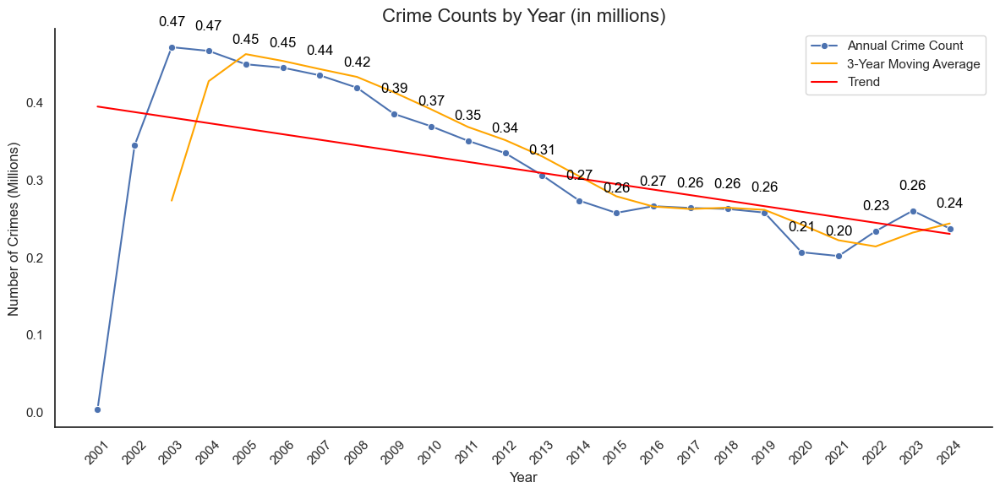

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
import pandas as pd
crime_counts_by_year = data.groupby('Year').size()
# Scale the number of crimes by millions for better readability
crime_counts_by_year_scaled = crime_counts_by_year / 1e6
# Calculate the moving average; change the window size as needed
moving_average = crime_counts_by_year_scaled.rolling(window=3).mean()
# Set the aesthetics for the plot using seaborn
sns.set(style="white")
# Define an offset for label positioning to prevent overlap
offset = max(crime_counts_by_year_scaled) * 0.05  # Adjust this value as needed
# Plot the results
plt.figure(figsize=(12, 6))
# Plot the scaled crime counts
sns.lineplot(x=crime_counts_by_year.index, y=crime_counts_by_year_scaled, marker='o', label='Annual Crime Count')
# Plot the moving average
sns.lineplot(x=crime_counts_by_year.index, y=moving_average, color='orange', label='3-Year Moving Average')
# Fit a linear regression to the yearly crime data to find the trend
X = crime_counts_by_year.index.values.reshape(-1, 1)  # Year
y = crime_counts_by_year_scaled.values  # Crime count scaled
# Fit the model
model = LinearRegression()
model.fit(X, y)
# Predict the values
trend = model.predict(X)
# Add trend line to the plot
sns.lineplot(x=crime_counts_by_year.index, y=trend, label='Trend', color='red')
# Enhance the x-axis to show each year
plt.xticks(crime_counts_by_year.index, rotation=45)
# Adjust data labels to prevent overlap
for year, count in crime_counts_by_year_scaled.items():
    if pd.notnull(moving_average[year]):
        plt.text(year, count + offset, f"{count:.2f}", color='black', ha='center', va='bottom')

# Additional styling for the plot
plt.title('Crime Counts by Year (in millions)', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Number of Crimes (Millions)', fontsize=12)
plt.tight_layout()
# Remove the grid
sns.despine()
# Show the plot
plt.show()


Analyzing Daily Crime Trends: A Twenty-Year Perspective

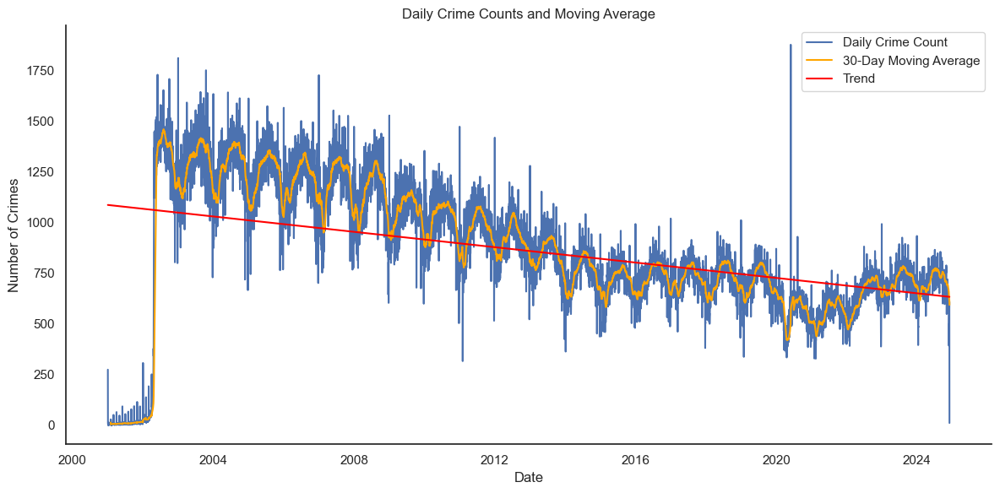

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
data.set_index('Date', inplace=True)
# Resample to get daily crime counts
daily_crime_counts = data.resample('D').size()
# Calculate a 30-day moving average for the daily data
moving_average_daily = daily_crime_counts.rolling(window=30).mean()
# Generate a date range for plotting based on the daily data
date_range = pd.date_range(start=daily_crime_counts.index.min(), end=daily_crime_counts.index.max())
# Fit a linear regression for trend using the daily data
X = np.arange(len(date_range)).reshape(-1, 1)  # Convert dates to a numerical value for regression
y = daily_crime_counts.reindex(date_range, fill_value=0).values  # Use reindex to ensure we have no date gaps
# Fit the model
model = LinearRegression()
model.fit(X, y)
# Predict the trend values
trend_daily = model.predict(X)
# Plotting
plt.figure(figsize=(12, 6))
sns.lineplot(x=date_range, y=daily_crime_counts, label='Daily Crime Count')
sns.lineplot(x=date_range, y=moving_average_daily, label='30-Day Moving Average', color='orange')
plt.plot(date_range, trend_daily, label='Trend', color='red')
# Add title and labels
plt.title('Daily Crime Counts and Moving Average')
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
# Removing the grid for a cleaner look
sns.despine()
# Show legend
plt.legend()
# Show plot
plt.tight_layout()
plt.show()

Crime Category Trends Over Two Decades: Diving into the Data


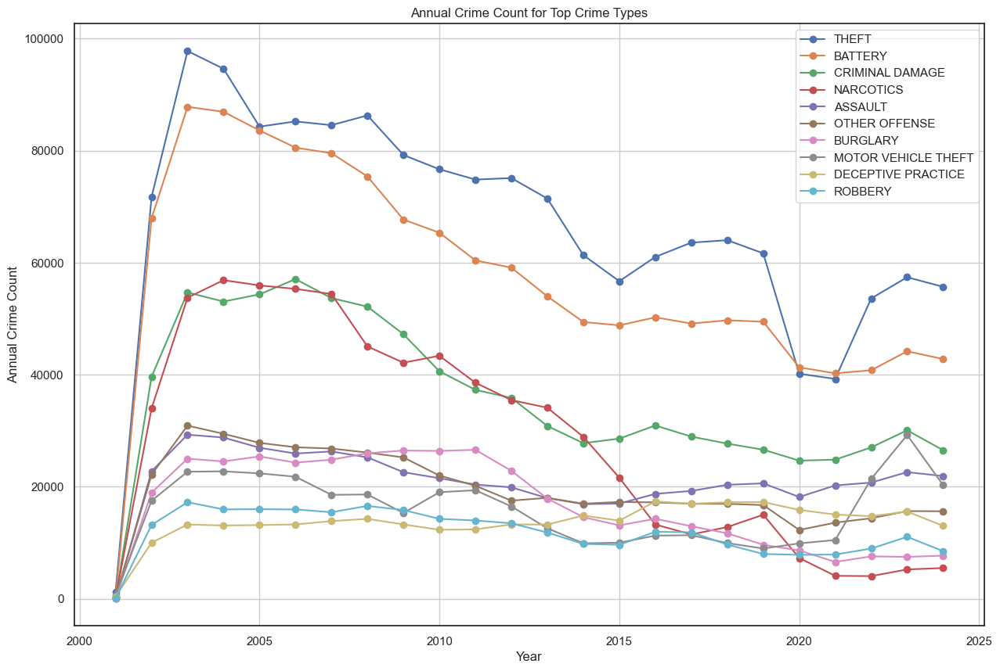

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
data['Year'] = pd.to_datetime(data['Year'], format='%Y')
# Group the data by 'Year' and 'Primary Type' and count the occurrences
crime_counts = data.groupby([data['Year'].dt.year, 'Primary Type']).size().unstack(fill_value=0)
# Calculate the top N crime types by overall count
top_crime_types = crime_counts.sum(axis=0).sort_values(ascending=False).head(10).index
# Filter the data to include only the top N crime types
top_crime_data = crime_counts[top_crime_types]
# Plotting
plt.figure(figsize=(15, 10))
# Plot each of the top crime types
for crime_type in top_crime_types:
    plt.plot(top_crime_data.index, top_crime_data[crime_type], marker='o', label=crime_type)
# Set up the plot
plt.title('Annual Crime Count for Top Crime Types')
plt.xlabel('Year')
plt.ylabel('Annual Crime Count')
plt.legend()
plt.grid(True)
plt.show()

High Correlation: A Reflective Analysis of Crime Incidents and Arrest Rates


The correlation coefficient between crime count and arrests is: 0.95


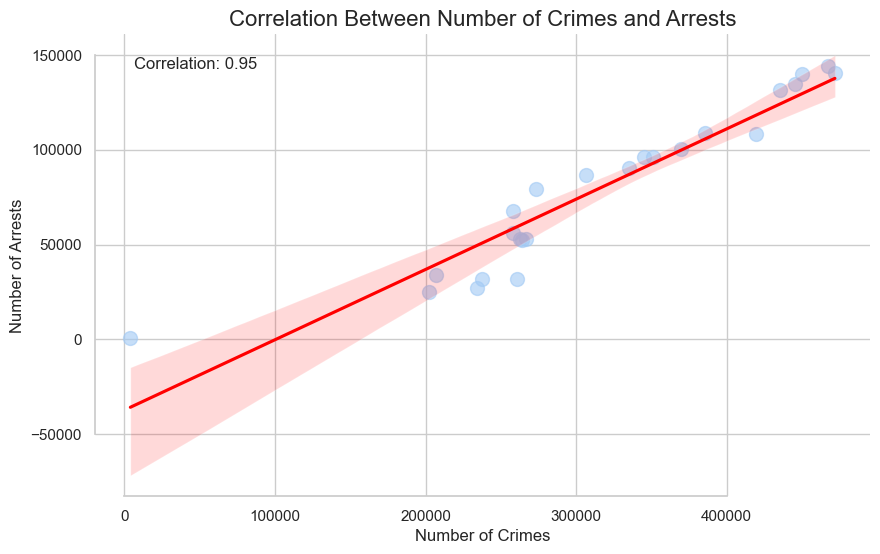

In [10]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

data['Arrest'] = data['Arrest'].astype(int)
aggregate_data = data.groupby('Year').agg({'ID': 'count', 'Arrest': 'sum'}).rename(columns={'ID': 'Crime Count'})

# Calculate the correlation coefficient
correlation = aggregate_data['Crime Count'].corr(aggregate_data['Arrest'])
print(f"The correlation coefficient between crime count and arrests is: {correlation:.2f}")

# Set the aesthetics for the plot
sns.set(style="whitegrid", palette="pastel", color_codes=True)

# Create a scatter plot with a regression line
plt.figure(figsize=(10, 6))
scatter_plot = sns.regplot(x='Crime Count', y='Arrest', data=aggregate_data, scatter_kws={'s': 100, 'alpha': 0.6}, line_kws={'color': 'red'})

# Enhance the plot
plt.title('Correlation Between Number of Crimes and Arrests', fontsize=16)
plt.xlabel('Number of Crimes', fontsize=12)
plt.ylabel('Number of Arrests', fontsize=12)

# Annotate the correlation coefficient on the plot
plt.text(0.05, 0.95, f'Correlation: {correlation:.2f}', transform=scatter_plot.transAxes, fontsize=12, verticalalignment='top')

# Remove the top and right spines
sns.despine(trim=True)

plt.show()


Shifting Crime Dynamics: A Two-Decade Perspective


In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from calendar import month_abbr


In [12]:
data = data.reset_index()

In [13]:
# Ensure the 'Year' column is of datetime type (if not already)
data['Year'] = pd.to_datetime(data['Year'], errors='coerce')

# Extract the year as an integer
data['Year'] = data['Year'].dt.year

# Now filter the data
data = data[data['Year'] >= 2003]
data['Arrest'] = data['Arrest'].astype(int)


In [14]:
# Convert 'Date' to datetime format (if not already)
data['Date'] = pd.to_datetime(data['Date'], errors='coerce')

# Extract the month from the 'Date' column
data['Month'] = data['Date'].dt.month


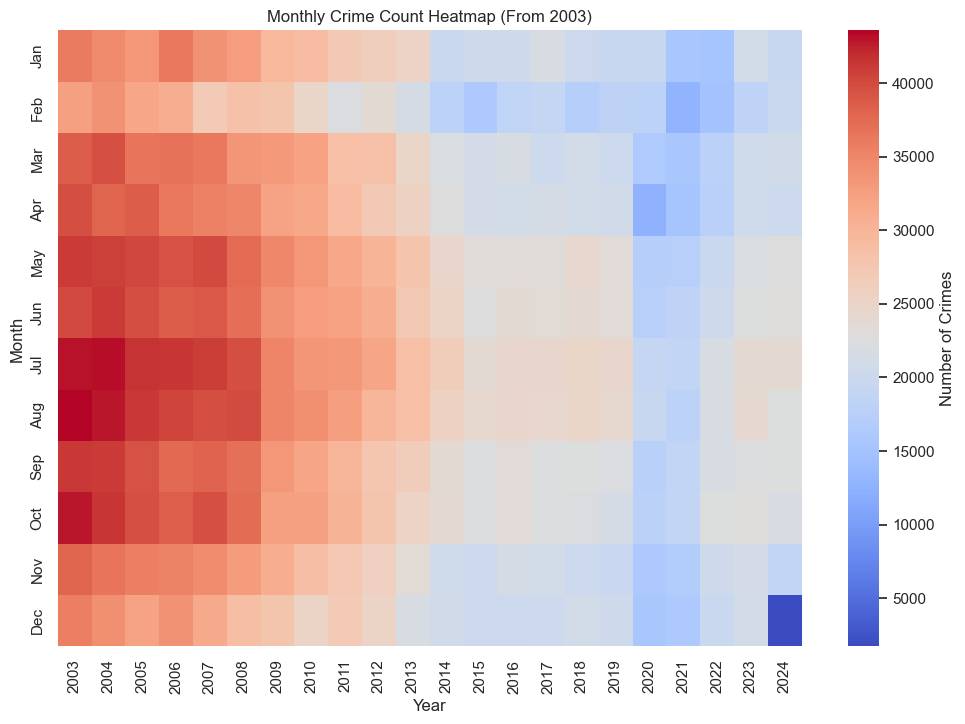

In [15]:

# Filter data to start from the year 2003
data = data[data['Year'] >= 2003]
# Group by year and month and count the number of cases
monthly_counts = data.groupby(['Year', 'Month']).size().reset_index(name='Crime Count')
# Pivot for heatmap

heatmap_data = monthly_counts.pivot(index='Month', columns='Year', values='Crime Count')

# Sort the months in calendar order and update the index to month names
heatmap_data.index = [month_abbr[i] for i in heatmap_data.index]
# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='coolwarm', cbar_kws={'label': 'Number of Crimes'})
# Add title and axis labels
plt.title('Monthly Crime Count Heatmap (From 2003)')
plt.ylabel('Month')
plt.xlabel('Year')
plt.show()


Seasonal Crime Patterns: Summer Surge and Winter Lull


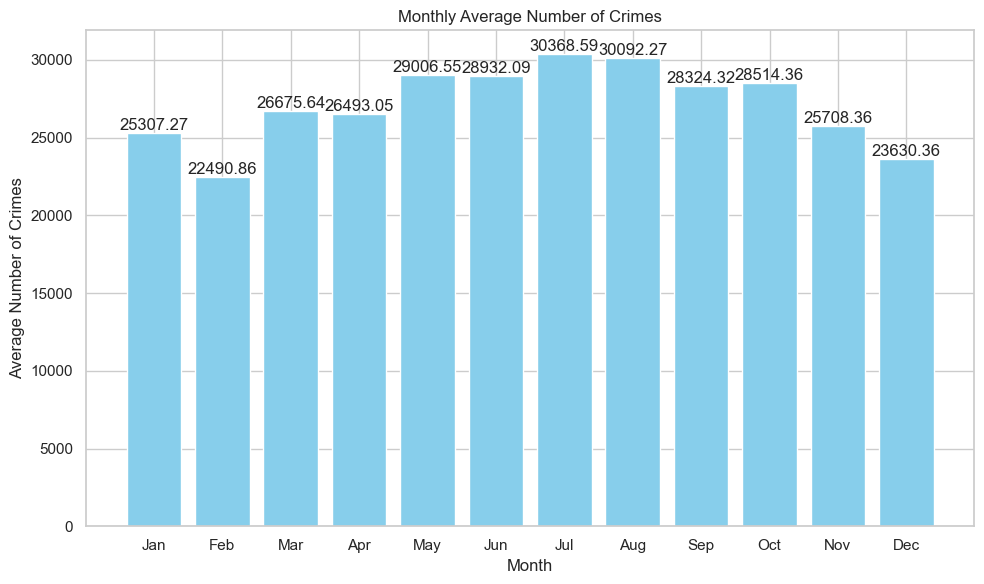

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
data['Date'] = pd.to_datetime(data['Date'])
data['Year'] = data['Date'].dt.year
data['Month'] = data['Date'].dt.month
# Group by year and month and count the number of cases
monthly_data = data.groupby(['Year', 'Month']).agg({'Case Number': 'count'}).reset_index()
# Calculate the average number of cases for each month across all years
monthly_average = monthly_data.groupby('Month')['Case Number'].mean()
# Create the bar plot
plt.figure(figsize=(10, 6))
bars = plt.bar(monthly_average.index, monthly_average.values, color='skyblue')
# Add data labels on top of the bars
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.2f}', ha='center', va='bottom')
# Set the x-tick labels to month names
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
plt.xticks(monthly_average.index, month_names)
plt.title('Monthly Average Number of Crimes')
plt.xlabel('Month')
plt.ylabel('Average Number of Crimes')
plt.tight_layout()  # Adjust the layout to fit everything nicely
plt.show()

Disparity in Crime Across Neighborhoods: Identifying High and Low-Risk Areas


In [17]:
def get_last_two_words(s):
    words = s.split()  # Split the string into a list of words
    return ' '.join(words[-2:])  # Join and return the last two words

In [18]:
data['Updated Block'] = data['Block'].apply(get_last_two_words)

C:\Users\Purundar\AppData\Local\Temp\ipykernel_11856\2228607479.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(x='Crime Count', y='Updated Block', data=final_plot_data, palette="RdBu_r")


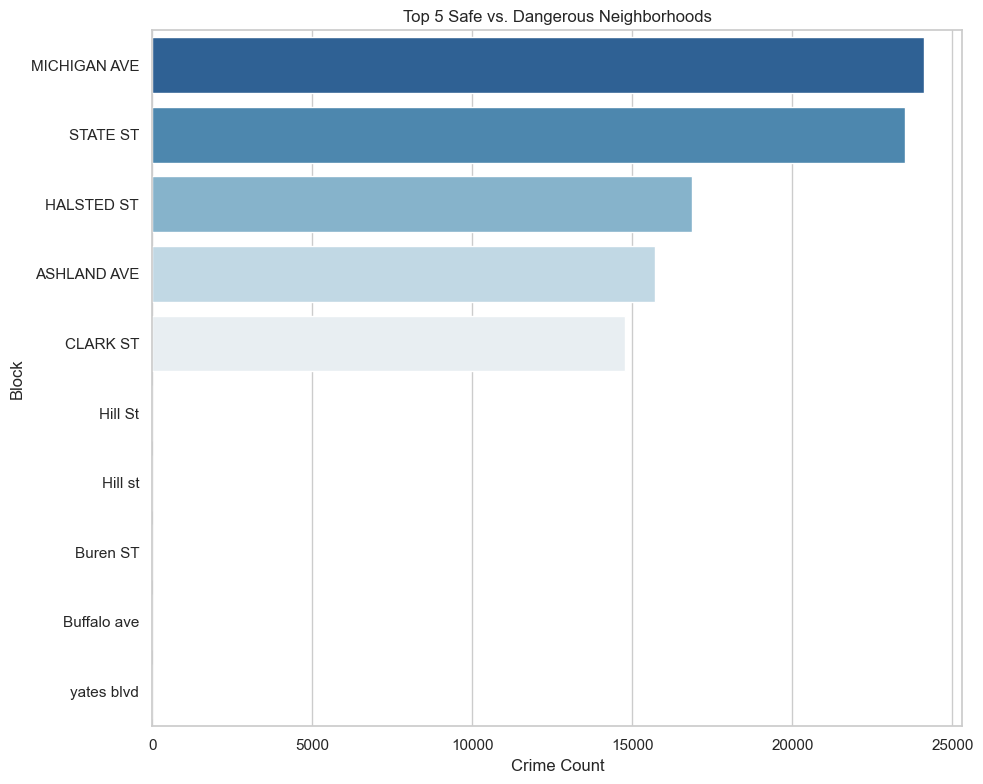

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
data['Date'] = pd.to_datetime(data['Date'])
recent_data = data[data['Date'].dt.year >= data['Date'].dt.year.max() - 5]
# Group by 'Block' and count the number of crimes
crime_counts_by_block = recent_data.groupby('Updated Block').size().reset_index(name='Crime Count')
# Sort the neighborhoods by crime count
sorted_crime_counts = crime_counts_by_block.sort_values('Crime Count', ascending=False)
# Select top 5 neighborhoods with the most crime
top_crime_blocks = sorted_crime_counts.head(5)
# Select top 5 neighborhoods with the least crime
# If the total number of blocks is less than 10, adjust this number accordingly
bottom_crime_blocks = sorted_crime_counts.tail(5)
# Combine top and bottom for the final DataFrame to plot
final_plot_data = pd.concat([top_crime_blocks, bottom_crime_blocks])
# Plotting
plt.figure(figsize=(10, 8))
barplot = sns.barplot(x='Crime Count', y='Updated Block', data=final_plot_data, palette="RdBu_r")
# Set plot title and labels
plt.title('Top 5 Safe vs. Dangerous Neighborhoods')
plt.xlabel('Crime Count')
plt.ylabel('Block')
# Show plot
plt.tight_layout()
plt.show()

In [20]:
data.columns

Index(['Date', 'ID', 'Case Number', 'Block', 'IUCR', 'Primary Type',
       'Description', 'Location Description', 'Arrest', 'Domestic', 'Beat',
       'District', 'Ward', 'Community Area', 'FBI Code', 'X Coordinate',
       'Y Coordinate', 'Year', 'Updated On', 'Latitude', 'Longitude',
       'Location', 'Month', 'Updated Block'],
      dtype='object')

Deciphering Crime Patterns: Time of Day and Week Analysis


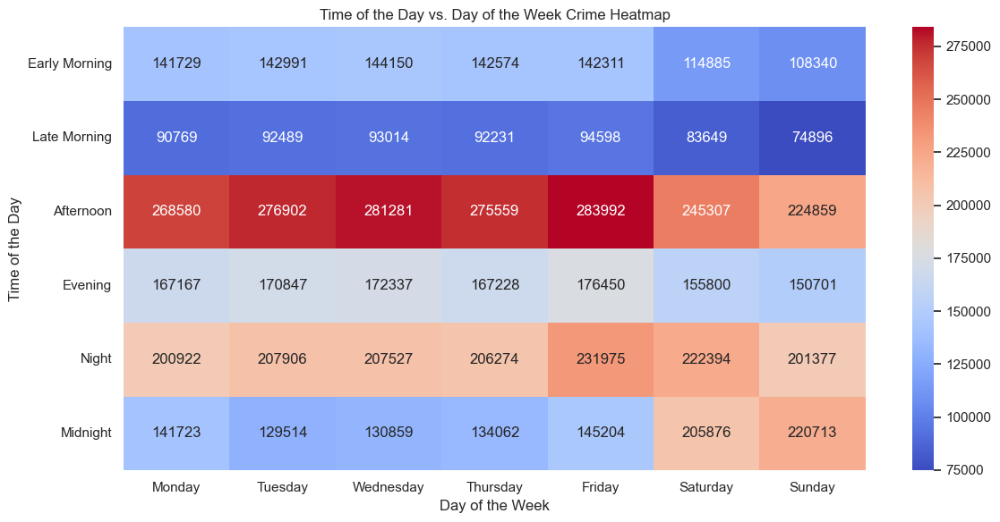

In [21]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Function to categorize time of day
def categorize_time_of_day(hour):
    if 5 <= hour < 10:
        return 'Early Morning'
    elif 10 <= hour < 12:
        return 'Late Morning'
    elif 12 <= hour < 17:
        return 'Afternoon'
    elif 17 <= hour < 20:
        return 'Evening'
    elif 20 <= hour < 24:
        return 'Night'
    else:
        return 'Midnight'

# Ensure 'Date' is in datetime format
data['Date'] = pd.to_datetime(data['Date'], errors='coerce')

# Create 'Hour', 'Time of the Day', and 'Day of the Week' columns
data['Hour'] = data['Date'].dt.hour
data['Time of the Day'] = data['Hour'].apply(categorize_time_of_day)
data['Day of the Week'] = data['Date'].dt.day_name()

# Group data and count occurrences
crime_counts = (
    data.groupby(['Time of the Day', 'Day of the Week'])['ID']
    .count()
    .reset_index(name='Crime Count')
)

# Create pivot table
pivot_table = crime_counts.pivot(
    index='Time of the Day',
    columns='Day of the Week',
    values='Crime Count'
)

# Reindex rows and columns
ordered_days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
pivot_table = pivot_table.reindex(columns=ordered_days)

ordered_times = ['Early Morning', 'Late Morning', 'Afternoon', 'Evening', 'Night', 'Midnight']
pivot_table = pivot_table.reindex(index=ordered_times)

# Plot the heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(pivot_table, annot=True, fmt='g', cmap='coolwarm')
plt.title('Time of the Day vs. Day of the Week Crime Heatmap')
plt.xlabel('Day of the Week')
plt.ylabel('Time of the Day')
plt.tight_layout()
plt.show()


Dissecting Chicago's Crime Landscape: Prevalence and Nature of Offenses


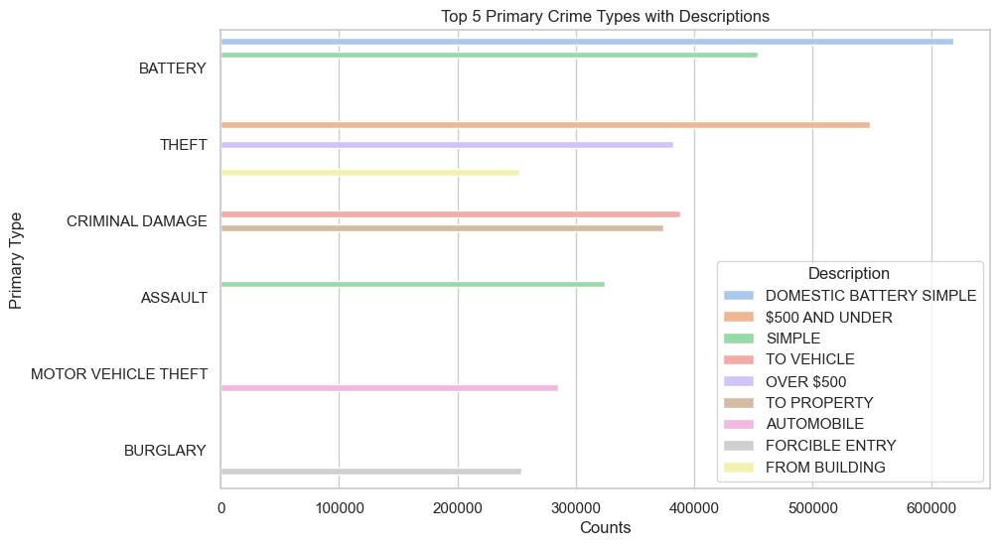

In [22]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
crime_counts = data.groupby(['Primary Type', 'Description']).size().reset_index(name='Counts')
# Sort by count in descending order and take the top 5
top_crimes = crime_counts.sort_values('Counts', ascending=False).head(10)
# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(data=top_crimes, x='Counts', y='Primary Type', hue='Description')
# Adding aesthetics
plt.title('Top 5 Primary Crime Types with Descriptions')
plt.xlabel('Counts')
plt.ylabel('Primary Type')
plt.legend(title='Description')
# Display the plot
plt.show()

In [23]:
data.head()

,Date,ID,Case Number,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Year,Updated On,Latitude,Longitude,Location,Month,Updated Block,Hour,Time of the Day,Day of the Week
0,2021-05-24 15:06:00,25953,JE240540,020XX N LARAMIE AVE,0110,HOMICIDE,FIRST DEGREE MURDER,STREET,1,False,...,2021,2023-11-18 15:39:49,41.917838,-87.755969,"(41.917838056, -87.755968972)",5,LARAMIE AVE,15,Afternoon,Monday
1,2021-06-26 09:24:00,26038,JE279849,062XX N MC CORMICK RD,0110,HOMICIDE,FIRST DEGREE MURDER,PARKING LOT,1,False,...,2021,2023-11-18 15:39:49,41.995219,-87.713355,"(41.995219444, -87.713354912)",6,CORMICK RD,9,Early Morning,Saturday
2,2023-11-09 07:30:00,13279676,JG507211,019XX W BYRON ST,0620,BURGLARY,UNLAWFUL ENTRY,APARTMENT,0,False,...,2023,2023-11-18 15:39:49,41.952345,-87.677975,"(41.952345086, -87.677975059)",11,BYRON ST,7,Early Morning,Thursday
3,2023-11-12 07:59:00,13274752,JG501049,086XX S COTTAGE GROVE AVE,0454,BATTERY,"AGGRAVATED P.O. - HANDS, FISTS, FEET, NO / MIN...",SMALL RETAIL STORE,1,False,...,2023,2023-12-09 15:41:24,41.737751,-87.604856,"(41.737750767, -87.604855911)",11,GROVE AVE,7,Early Morning,Sunday
4,2023-09-06 17:00:00,13203321,JG415333,002XX N Wells st,1320,CRIMINAL DAMAGE,TO VEHICLE,PARKING LOT / GARAGE (NON RESIDENTIAL),0,False,...,2023,2023-11-04 15:40:18,41.886018,-87.633938,"(41.886018055, -87.633937881)",9,Wells st,17,Evening,Wednesday


Friday Evening Crime Breakdown: A Closer Look at Incident Types


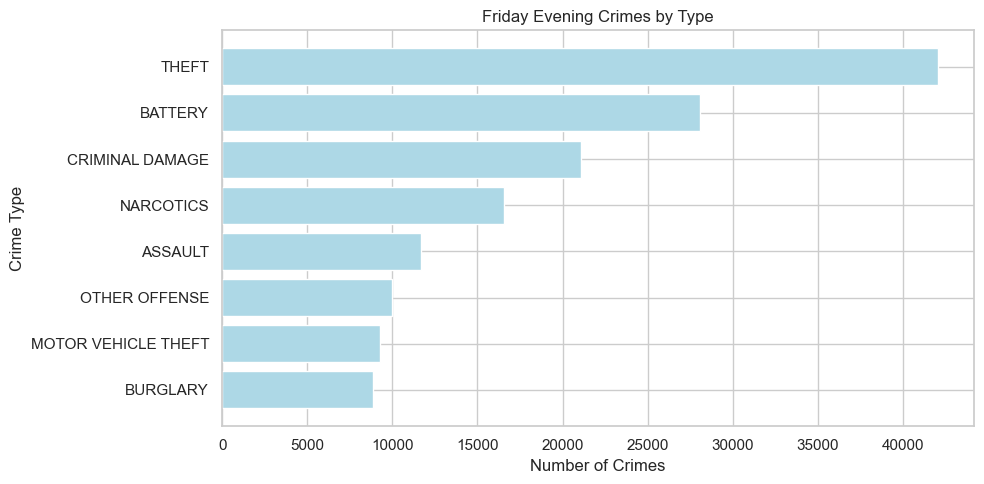

In [24]:
import pandas as pd
import matplotlib.pyplot as plt

# Ensure the 'Date' column is in datetime format
#
data = data.reset_index()
data['Date'] = pd.to_datetime(data['Date'])


# Filter the DataFrame for crimes occurring on Friday evenings
friday_evenings = data[
    (data['Date'].dt.day_name() == 'Friday') & 
    (data['Time of the Day'] == 'Evening')
]

# Count the top 8 crime types for Friday evenings
crime_counts = (
    friday_evenings['Primary Type']
    .value_counts()
    .reset_index(name='Count')
    .head(8)
)
crime_counts.columns = ['Primary Type', 'Count']

# Create a horizontal bar chart
plt.figure(figsize=(10, 5))
plt.barh(crime_counts['Primary Type'], crime_counts['Count'], color='lightblue')
plt.xlabel('Number of Crimes')
plt.ylabel('Crime Type')
plt.title('Friday Evening Crimes by Type')

# Invert the y-axis so the highest counts appear at the top
plt.gca().invert_yaxis()

plt.tight_layout()
plt.show()


Analyzing Crime and Arrest Trends: Opportunities for Enhanced Policing Strategies


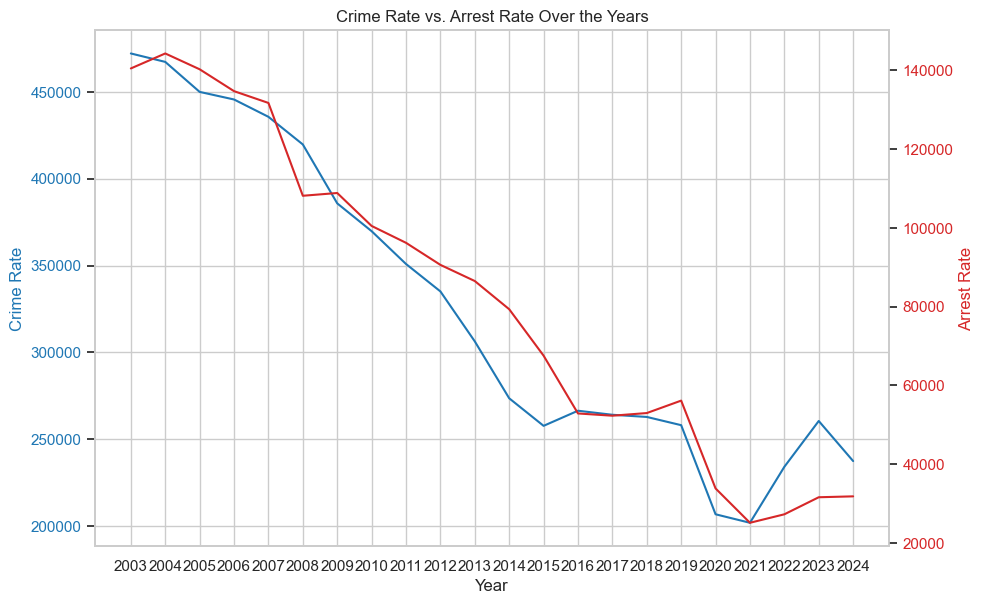

The correlation coefficient between crime count and arrests is: 0.97


In [25]:
import pandas as pd
import matplotlib.pyplot as plt
yearly_crime_rates = data.groupby('Year').size().rename('Crime Rate')
# Calculate yearly arrest rates (number of arrests per year)
yearly_arrest_rates = data[data['Arrest'] == 1].groupby('Year').size().rename('Arrest Rate')
# Combine the two series into a DataFrame
rates_df = pd.concat([yearly_crime_rates, yearly_arrest_rates], axis=1)
# Plotting the yearly crime rates and arrest rates
fig, ax1 = plt.subplots(figsize=(10, 6))
color = 'tab:blue'
ax1.set_xlabel('Year')
ax1.set_ylabel('Crime Rate', color=color)
ax1.plot(rates_df.index, rates_df['Crime Rate'], color=color)
ax1.tick_params(axis='y', labelcolor=color)
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
color = 'tab:red'
ax2.set_ylabel('Arrest Rate', color=color)  # we already handled the x-label with ax1
ax2.plot(rates_df.index, rates_df['Arrest Rate'], color=color)
ax2.tick_params(axis='y', labelcolor=color)
fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.title('Crime Rate vs. Arrest Rate Over the Years')
plt.xticks(ticks=np.arange(min(rates_df.index), max(rates_df.index) + 1, 1.0), labels=np.arange(min(rates_df.index), max(rates_df.index) + 1, 1.0).astype(int))
plt.grid(False)
plt.show()
# Calculate the correlation coefficient
correlation = rates_df.corr().iloc[0,1]
print(f"The correlation coefficient between crime count and arrests is: {correlation:.2f}")


2024 Crime Forecast: Predictive Analysis for Proactive Policing


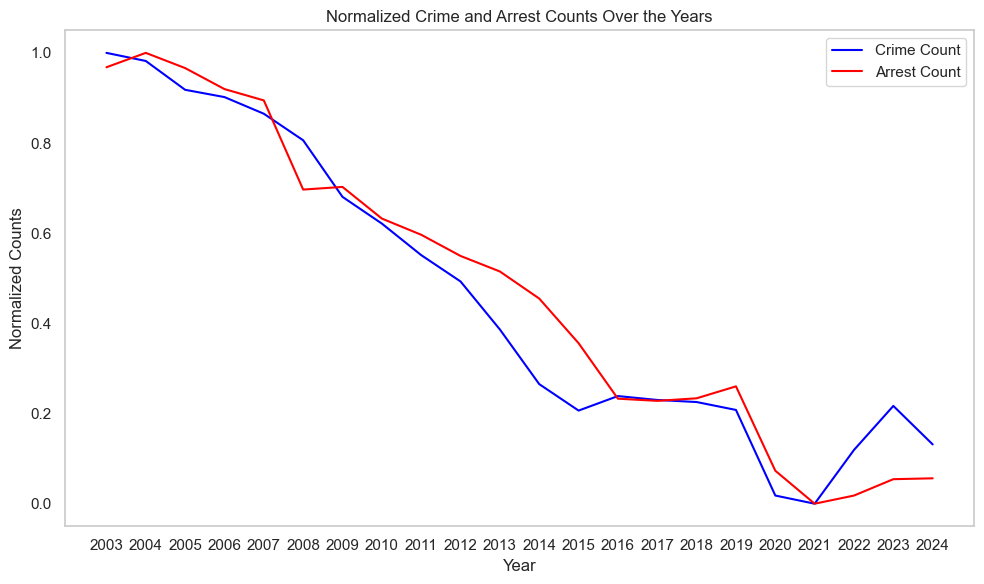

    Year  Crime Count  Arrest Count
0   2003     1.000000      0.968102
1   2004     0.982034      1.000000
2   2005     0.918110      0.966290
3   2006     0.901934      0.919681
4   2007     0.864999      0.894572
5   2008     0.806119      0.696791
6   2009     0.680601      0.702674
7   2010     0.621351      0.632484
8   2011     0.551419      0.596541
9   2012     0.492969      0.549546
10  2013     0.386487      0.515097
11  2014     0.265265      0.455036
12  2015     0.206568      0.356087
13  2016     0.238758      0.232943
14  2017     0.230134      0.228152
15  2018     0.225530      0.233791
16  2019     0.207979      0.260309
17  2020     0.018129      0.073178
18  2021     0.000000      0.000000
19  2022     0.119262      0.018068
20  2023     0.216903      0.054405
21  2024     0.131512      0.056318


In [26]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
# Calculate yearly crime rates (number of crimes per year)
yearly_crime_counts = data.groupby('Year').size()
# Calculate yearly arrest rates (number of arrests per year)
yearly_arrest_counts = data[data['Arrest'] == 1].groupby('Year').size()
# Combine the two series into a DataFrame
rates_df = pd.DataFrame({
    'Year': yearly_crime_counts.index,
    'Crime Count': yearly_crime_counts.values,
    'Arrest Count': yearly_arrest_counts.reindex(yearly_crime_counts.index, fill_value=0).values
})
rates_df['Year'] = rates_df['Year'].astype('category')
# Normalize the data for better comparison in the plot
# We use min-max scaling to transform the data to fit within a similar range
scaler = MinMaxScaler()
rates_df[['Crime Count', 'Arrest Count']] = scaler.fit_transform(rates_df[['Crime Count', 'Arrest Count']])
# Plotting the yearly crime counts and arrest counts
# Plotting the yearly crime counts and arrest counts
plt.figure(figsize=(10, 6))
plt.plot(rates_df['Year'].astype(str), rates_df['Crime Count'], label='Crime Count', color='blue')  # Convert year to string if you want categorical x-axis
plt.plot(rates_df['Year'].astype(str), rates_df['Arrest Count'], label='Arrest Count', color='red')  # Convert year to string if you want categorical x-axis
plt.title('Normalized Crime and Arrest Counts Over the Years')
plt.xlabel('Year')
plt.ylabel('Normalized Counts')
plt.legend()
plt.grid(False)  # Set to True to show the grid for better readability
 # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust the padding to ensure everything fits without overlap
plt.show()
# Display a table with the normalized data for detailed comparison
print(rates_df)

In [27]:
import pandas as pd
import statsmodels.api as sm
data = data.reset_index()
# Convert 'Date' to datetime and set it as the DataFrame index
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)
# Aggregate the crime data by day
daily_crime_counts = data['Case Number'].resample('D').count()
# Fit a seasonal ARIMA model
# The order of p, d, q and seasonal_order P, D, Q, s should be determined using grid search or AIC/BIC criteria
sarima_model = sm.tsa.statespace.SARIMAX(daily_crime_counts,
                                          order=(1, 1, 1),
                                          seasonal_order=(1, 1, 1, 7),
                                          enforce_stationarity=False,
                                          enforce_invertibility=False)

results = sarima_model.fit()
# Predict for the entire year of 2024
# The start and end dates should be the first and last days of 2024, respectively
pred = results.get_prediction(start=pd.to_datetime('2025-01-01'), 
                              end=pd.to_datetime('2025-12-31'), dynamic=True)
pred_conf = pred.conf_int()
# This will give you daily predictions for 2024
predicted_crime_counts = pred.predicted_mean
# Aggregate these predictions by month for monthly predictions
monthly_crime_predictions = predicted_crime_counts.resample('M').sum()
# To determine the specific days, you can simply look at the days with the highest predicted counts
days_with_highest_crimes = predicted_crime_counts.nlargest(n=10) # or any number you see fit
# Now, print out the results
print("Monthly crime predictions for 2025:")
print(monthly_crime_predictions)
print("\nDays with highest predicted crimes for 2025:")
print(days_with_highest_crimes)


Monthly crime predictions for 2025:
2025-01-31    14788.455038
2025-02-28    13066.434313
2025-03-31    14154.808801
2025-04-30    13327.212290
2025-05-31    13468.381646
2025-06-30    12690.723484
2025-07-31    12731.436808
2025-08-31    12454.964416
2025-09-30    11677.764253
2025-10-31    11726.551851
2025-11-30    11044.676492
2025-12-31    11030.261392
Freq: ME, Name: predicted_mean, dtype: float64

Days with highest predicted crimes for 2025:
2025-01-03    498.554916
2025-01-04    496.635298
2025-01-10    496.022332
2025-01-11    494.102709
2025-01-17    493.489741
2025-01-18    491.570117
2025-01-24    490.957149
2025-01-25    489.037525
2025-01-31    488.424557
2025-02-01    486.504934
Name: predicted_mean, dtype: float64


C:\Users\Purundar\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\kalman_filter.py:2473: ValueWarning: Dynamic prediction specified to begin during out-of-sample forecasting period, and so has no effect.
  warn('Dynamic prediction specified to begin during'
C:\Users\Purundar\AppData\Local\Temp\ipykernel_11856\1162180811.py:26: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_crime_predictions = predicted_crime_counts.resample('M').sum()


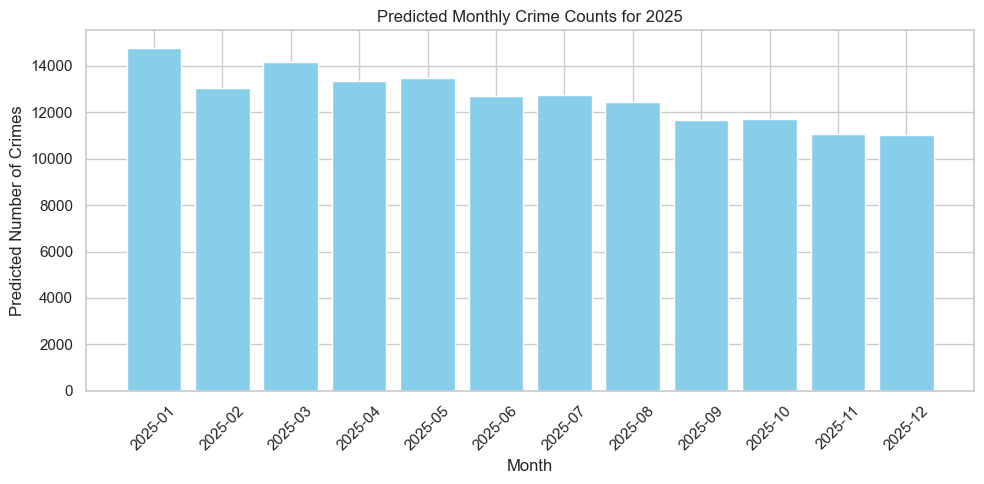

In [31]:
import matplotlib.pyplot as plt
import pandas as pd
monthly_crime_predictions.index = pd.to_datetime(monthly_crime_predictions.index)
# Create the plot
plt.figure(figsize=(10, 5))
plt.bar(monthly_crime_predictions.index.strftime('%Y-%m'), monthly_crime_predictions.values, color='skyblue')
plt.title('Predicted Monthly Crime Counts for 2025')
plt.xlabel('Month')
plt.ylabel('Predicted Number of Crimes')
plt.xticks(rotation=45)
plt.tight_layout()  # Adjust the layout to make room for the x-axis labels
plt.show()


In [29]:
data.columns

Index(['level_0', 'index', 'ID', 'Case Number', 'Block', 'IUCR',
       'Primary Type', 'Description', 'Location Description', 'Arrest',
       'Domestic', 'Beat', 'District', 'Ward', 'Community Area', 'FBI Code',
       'X Coordinate', 'Y Coordinate', 'Year', 'Updated On', 'Latitude',
       'Longitude', 'Location', 'Month', 'Updated Block', 'Hour',
       'Time of the Day', 'Day of the Week'],
      dtype='object')

Land Heat Map Generation

In [30]:
import folium
from folium.plugins import HeatMap
# Group data by 'Updated Block' and count crimes
crime_counts = data.groupby(['Latitude', 'Longitude']).size().reset_index(name='counts')
# Create a map
m = folium.Map(location=[39.8283, -98.5795], zoom_start=5)  # Center of the US
# Add heat map
heat_data = [[row['Latitude'], row['Longitude'], row['counts']] for index, row in crime_counts.iterrows()]
HeatMap(heat_data).add_to(m)
# Save it to an HTML file
m.save('heatmap.html')
m